# Vizgen Mouse Liver Squidpy Vignette
This vignette shows how to use the libraries Squidpy and Scanpy to analyze MERFISH data from the [Vizgen MERFISH Mouse Liver Map](https://info.vizgen.com/mouse-liver-access). This notebook analyzes a MERFISH dataset that measures 347 genes across over >300,000 liver cells in a single mouse liver slice.

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import squidpy as sq
from scipy.cluster import hierarchy as sch
from matplotlib import pyplot as plt
from copy import deepcopy
%matplotlib inline  

<IPython.core.display.Javascript object>

# Single-Cell Clustering of Vizgen MERFISH Mouse Liver Data
### Load MERFISH Data into AnnData Object
First, we load the cell-by-gene and cell-metadata CSVs and construct an AnnData object `adata`.

In [ ]:
# Datasets can be obtained from the Vizgen Data release website (see above)
cell_by_gene = pd.read_csv('cell_by_gene.csv', index_col=0)
meta_cell = pd.read_parquet('meta_cell.csv', index_col=0)

# initialize meta_gene
meta_gene = pd.DataFrame(index=cell_by_gene.columns.tolist())

# drop blanks for single cell analysis
keep_genes = [x for x in cell_by_gene.columns.tolist() if 'Blank' not in x]
cell_by_gene = cell_by_gene[keep_genes]
meta_gene = meta_gene.loc[keep_genes]

# calculate barcode counts
meta_cell['barcodeCount'] = cell_by_gene.sum(axis=1)
meta_gene['expression'] = cell_by_gene.sum(axis=0)

# filter out cells with low expression
min_count = 50
keep_cells = meta_cell[meta_cell['barcodeCount'] >= min_count].index.tolist()
meta_cell = meta_cell.loc[keep_cells]
cell_by_gene = cell_by_gene.loc[keep_cells]

# reset index of cell_by_gene and meta_cell
new_index = range(len(meta_cell.index.tolist()))
meta_cell.index = new_index
cell_by_gene.index = new_index
cell_by_gene.shape

adata = sc.AnnData(X=cell_by_gene.values, obs=meta_cell, var=meta_gene)
adata

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 367235 × 347
    obs: 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max_x', 'min_y', 'max_y', 'barcodeCount'
    var: 'expression'

### Data Pre-processing
Here we use Scanpy total-count normalize, logarithmize, and scale gene expression to unit variance (clipping values that exceed 10 standard deviations).

In [ ]:
print('normalize total')
sc.pp.normalize_total(adata)
print('log transform')
sc.pp.log1p(adata)
print('scale')
sc.pp.scale(adata, max_value=10)

<IPython.core.display.Javascript object>

normalize total
log transform
scale


### Dimensionality Reduction, Neighbor Calculation, and Clustering

Here we use Scanpy to: reduce the dimensionality of our data by running principal component analysis (PCA), calculate the neighborhood graph of cells in PCA space, display cells in a two-dimensional UMAP embedding, and finally identify clusters of cells using Ledien clustering.

In [ ]:
resolution = 1.5
print('PCA')
sc.tl.pca(adata, svd_solver='arpack')
print('neighbors')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
print('UMAP')
sc.tl.umap(adata)
print('Leiden')
sc.tl.leiden(adata, resolution=resolution)

<IPython.core.display.Javascript object>

PCA
neighbors
UMAP
Leiden


In [ ]:
# set spatial coordinates of cells
mat_spatial = deepcopy(adata.obs[['center_x', 'center_y']])
adata.obsm['spatial'] = mat_spatial

### UMAP with Leiden Clustering Labels
Here we visualize the distributions of the Leiden clusters in the UMAP plot. We see Leiden clusters tend to segregate into distinct regions within the UMAP plot.

<IPython.core.display.Javascript object>

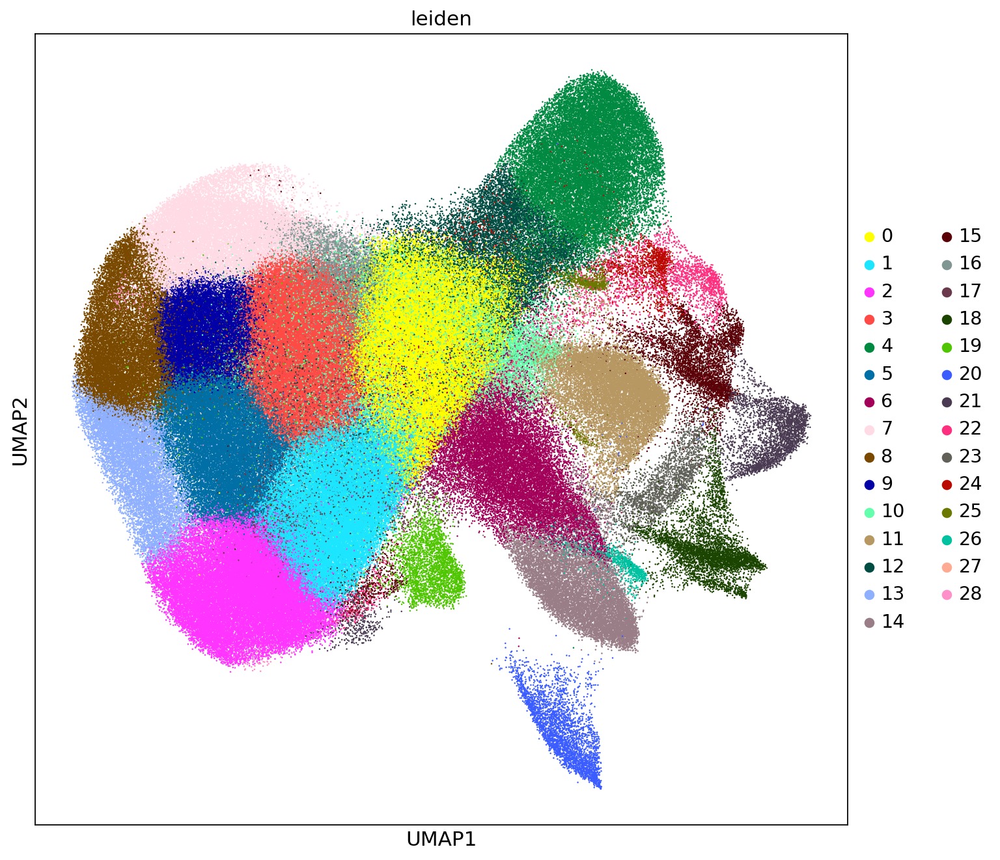

In [ ]:
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(adata, color=['leiden'], size=5)

### Spatial Distributions of Cells
Here we visualize the spatial locations of cells in the mouse liver colored by Leiden cluster. We observe distinct spatial localizations of Leiden clusters throughout the tissue. We see some clusters line blood vessels and while others form concentric patterns reflecting hepatic zonation ([Cunningham et. al. 2021](https://www.frontiersin.org/articles/10.3389/fphys.2021.732929/full)). Our next step is to assign tentative cell type to our Leiden clusters and assess their spatial localizations in the liver.

<IPython.core.display.Javascript object>

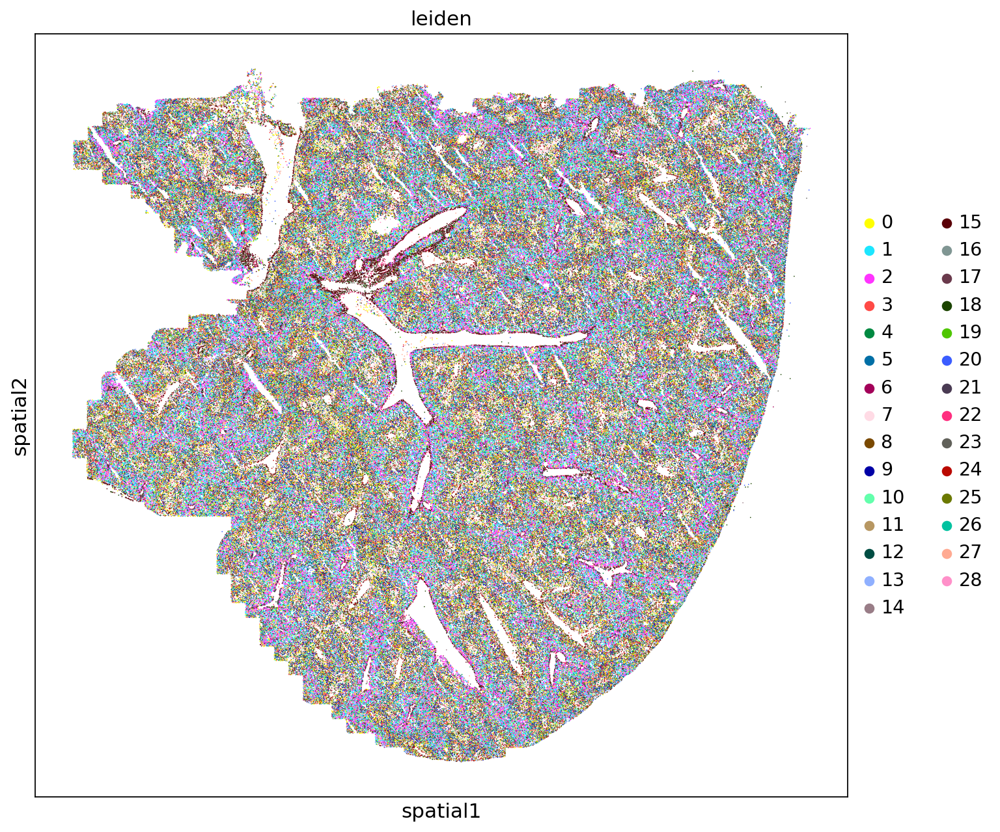

In [ ]:
sc.set_figure_params(figsize=(10,10))
sc.pl.spatial(
    adata,
    color="leiden",
    spot_size=15,
)

# Assing Cell Types
### Reference Cell Type Marker Gene Sets

In order to tentatively assign liver cell types we utilize a gene-level cell type marker reference from the publication [Spatial transcriptome profiling by MERFISH reveals fetal liver hematopoietic stem cell niche architecture](https://www.nature.com/articles/s41421-021-00266-1). These marker genes will be used to assess cell type composition of the Leiden clusters. See MERFISH gene panel metadata: https://www.nature.com/articles/s41421-021-00266-1.

In [ ]:
gene_panel = 'https://static-content.springer.com/esm/art%3A10.1038%2Fs41421-021-00266-1/MediaObjects/41421_2021_266_MOESM1_ESM.xlsx'
df_ref_panel_ini = pd.read_excel(gene_panel, index_col=0)
df_ref_panel = df_ref_panel_ini.iloc[1:,:1]
df_ref_panel.index.name = None
df_ref_panel.columns = ['Function']

# Assign marker gene metadata using reference dataset
marker_genes = df_ref_panel[df_ref_panel['Function'].str.contains('marker')].index.tolist()
common_marker_genes = list(set(meta_gene.index.tolist()).intersection(marker_genes))
meta_gene.loc[common_marker_genes, 'Markers'] = df_ref_panel.loc[common_marker_genes, 'Function']
meta_gene['Markers'] = meta_gene['Markers'].apply(lambda x: 'N.A.' if 'marker' not in str(x) else x)
meta_gene['Markers'].value_counts()

<IPython.core.display.Javascript object>

N.A.                            285
HSC marker                        8
Hepatocyte marker                 5
Erythroid progenitor marker       5
Macrophage marker                 5
SEC marker                        5
Neutrophil marker                 5
MK marker                         5
Potential HSC marker              5
Pre-B cell marker                 5
Erythroid cell marker             4
EC marker                         4
AEC marker                        2
Myeloid marker                    2
Macrophage/Hepatocyte marker      1
Basophil marker                   1
Name: Markers, dtype: int64

### Calculate Leiden Cluster Average Expression Signatures
Here we calculate the average gene expression signatures of the Leiden clusters, which will be used to assign cell type composition.

In [ ]:
ser_counts = adata.obs['leiden'].value_counts()
ser_counts.name = 'cell counts'
meta_leiden = pd.DataFrame(ser_counts)

cat_name = 'leiden'
sig_leiden = pd.DataFrame(columns=adata.var_names, index=adata.obs[cat_name].cat.categories)                                                                                                 
for clust in adata.obs[cat_name].cat.categories: 
    sig_leiden.loc[clust] = adata[adata.obs[cat_name].isin([clust]),:].X.mean(0)
sig_leiden = sig_leiden.transpose()
leiden_clusters = ['Leiden-' + str(x) for x in sig_leiden.columns.tolist()]
sig_leiden.columns = leiden_clusters
meta_leiden.index = sig_leiden.columns.tolist()
meta_leiden['leiden'] = pd.Series(meta_leiden.index.tolist(), index=meta_leiden.index.tolist())

<IPython.core.display.Javascript object>

### Assign Cell Type Based on Top Expressed Marker Genes
Here we assign cell type composition to the Leiden clusters by counting the frequency of cell type marker genes in the top 30 most up-regulated genes for each cluster such that cell type is assigned based on the most frequently occuring marker genes. If there is a tie in the number of marker genes, we assing the cluster to more than one cell type. Using this approach nine Leiden clusters are assigned to be Hepatocyte containing clusters.

In [ ]:
meta_gene = pd.DataFrame(index=sig_leiden.index.tolist())
meta_gene['info'] = pd.Series('', index=meta_gene.index.tolist())
meta_gene['Markers'] = pd.Series('N.A.', index=sig_leiden.index.tolist())
meta_gene.loc[common_marker_genes, 'Markers'] = df_ref_panel.loc[common_marker_genes, 'Function']

meta_leiden['Cell_Type'] = pd.Series('N.A.', index=meta_leiden.index.tolist())
num_top_genes = 30
for inst_cluster in sig_leiden.columns.tolist():
  top_genes = sig_leiden[inst_cluster].sort_values(ascending=False).index.tolist()[:num_top_genes]
  
  inst_ser = meta_gene.loc[top_genes, 'Markers']
  inst_ser = inst_ser[inst_ser != 'N.A.']
  ser_counts = inst_ser.value_counts()

  max_count = ser_counts.max()

  max_cat = '_'.join(sorted(ser_counts[ser_counts == max_count].index.tolist()))
  max_cat = max_cat.replace(' marker', '').replace(' ', '-')

  print(inst_cluster, max_cat)  
  meta_leiden.loc[inst_cluster, 'Cell_Type'] = max_cat
    
# rename clusters
meta_leiden['name'] = meta_leiden.apply(lambda x: x['Cell_Type'] + '_' + x['leiden'] , axis=1)
leiden_names = meta_leiden['name'].values.tolist()
meta_leiden.index = leiden_names


# transfer cell type labels to single cells
leiden_to_cell_type = deepcopy(meta_leiden)
leiden_to_cell_type.set_index('leiden', inplace=True)
leiden_to_cell_type.index.name = None

adata.obs['Cell_Type'] = adata.obs['leiden'].apply(lambda x: leiden_to_cell_type.loc['Leiden-' + str(x), 'Cell_Type'])
adata.obs['Cluster'] = adata.obs['leiden'].apply(lambda x: leiden_to_cell_type.loc['Leiden-' + str(x), 'name'])

<IPython.core.display.Javascript object>

Leiden-0 SEC
Leiden-1 Hepatocyte
Leiden-2 Hepatocyte
Leiden-3 Hepatocyte
Leiden-4 SEC
Leiden-5 Hepatocyte
Leiden-6 Macrophage
Leiden-7 Hepatocyte
Leiden-8 Hepatocyte
Leiden-9 Hepatocyte
Leiden-10 AEC
Leiden-11 AEC_Potential-HSC
Leiden-12 SEC
Leiden-13 Hepatocyte
Leiden-14 Macrophage
Leiden-15 MK
Leiden-16 Erythroid-progenitor_Hepatocyte
Leiden-17 Hepatocyte
Leiden-18 HSC
Leiden-19 Neutrophil
Leiden-20 HSC_Pre-B-cell
Leiden-21 Neutrophil
Leiden-22 MK_Pre-B-cell_SEC
Leiden-23 HSC_Myeloid
Leiden-24 MK_Pre-B-cell_SEC
Leiden-25 SEC
Leiden-26 Macrophage
Leiden-27 MK
Leiden-28 Pre-B-cell


# Hepatocyte Zonation
Hepatocytes are the most abundant cell in the liver and have multiple roles in metabolism, endocrine production, protein synthesis, and detoxification. Hepatocytes form complex, radial structures called lobules that contain a central vein (low oxygen level) surrounded by peripheral portal veins (high oxygen level). Hepatocytes can also be broadly classified as peri-central or peri-portal based on their proximity to central and portal veins, respectively. 

### Central and Portal Blood Vessels
We can use the gene Vwf to identify endothelial cells ([Horvath et. al.  2004](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2716260/#:~:text=The%20most%20useful%20marker%20for,most%20common%20inherited%20bleeding%20disorder.)) that line liver blood vessels. Plotting Vwf expression level in single cells (below) shows clear enrichment at blood vessel borders. Note that Vwf expression can also be used to distinguish artifactual holes/tears in the liver from blood vessels.

Next, we use the expression of Axin2 to mark per-central regions ([Sun et. al. 2020](https://pubmed.ncbi.nlm.nih.gov/31866224/)). Plotting Axin2 expression level in single cells shows Axin2 lining a subset of all Vwf positive blood vessels, which allows us to distinguish peri-portal (Axin2 negative) and peri-central (Axin2 positive) blood vessels. Similarly, we can use Axin2 expression to identify peri-central hepatocyte Leiden clusters (see next section).

<IPython.core.display.Javascript object>

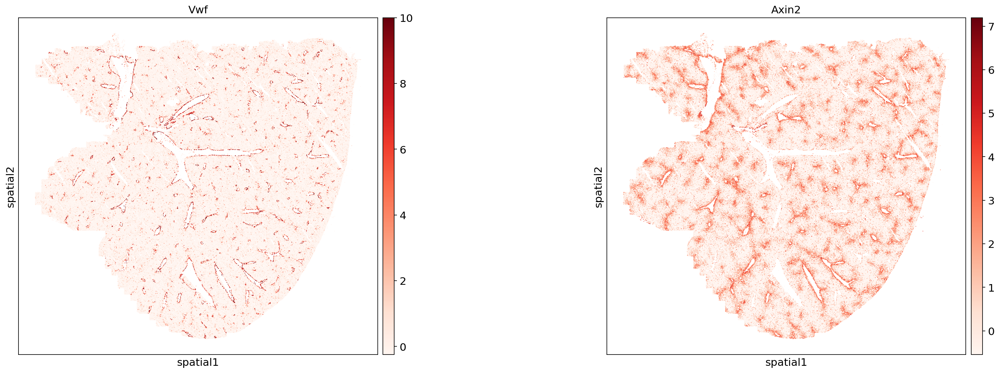

In [ ]:
sc.set_figure_params(figsize=(12,8))
sc.pl.spatial(
    adata,
    color=['Vwf', 'Axin2'],
    spot_size=20,
    cmap='Reds'
)

### Peri-Portal and Peri-Central Hepatocytes
As described above, we use the expression of Axin2 as a marker for peri-central hepatocytes ([see Sun et. al.](https://pubmed.ncbi.nlm.nih.gov/31866224/)). 

In [ ]:
all_hepatocyte_clusters = [x for x in meta_leiden.index.tolist() if 'Hepatocyte' in x]
sig_leiden.columns = meta_leiden.index.tolist()
ser_axin2 = sig_leiden[all_hepatocyte_clusters].loc['Axin2']
peri_central = ser_axin2[ser_axin2 > 0].index.tolist()
peri_portal = ser_axin2[ser_axin2 <= 0].index.tolist()

<IPython.core.display.Javascript object>

10

### Peri-Central Hepatocytes
Plotting peri-central and peri-portal hepatocytes separately displays their distinct interlocking morphologies with respect to blood vessels.

<IPython.core.display.Javascript object>

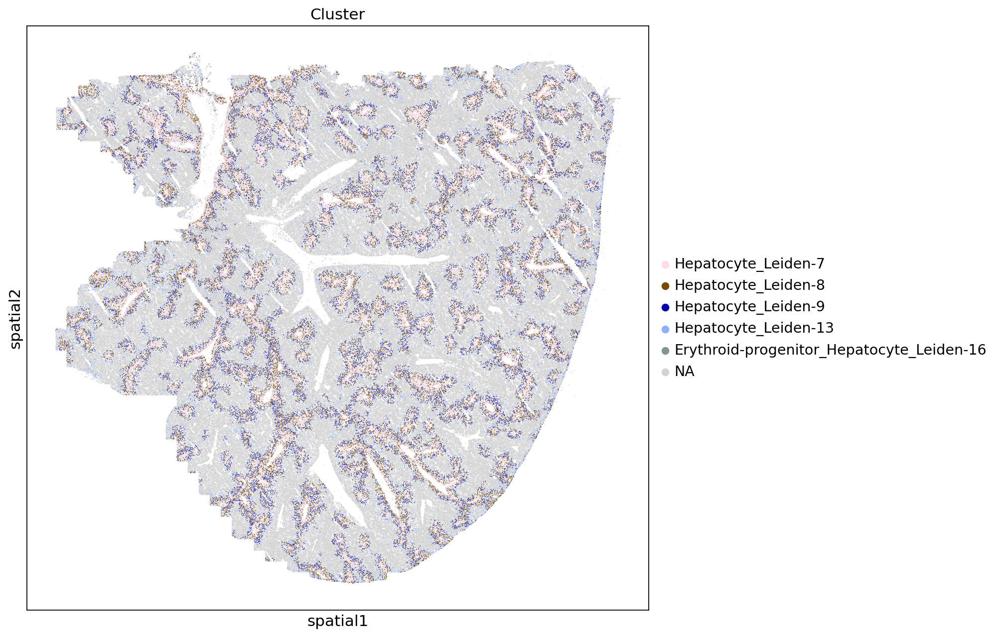

In [ ]:
sc.set_figure_params(figsize=(10,10))
sc.pl.spatial(
    adata,
    groups=peri_central, 
    color="Cluster",
    spot_size=15,
)

### Peri-Portal Hepatocytes

<IPython.core.display.Javascript object>

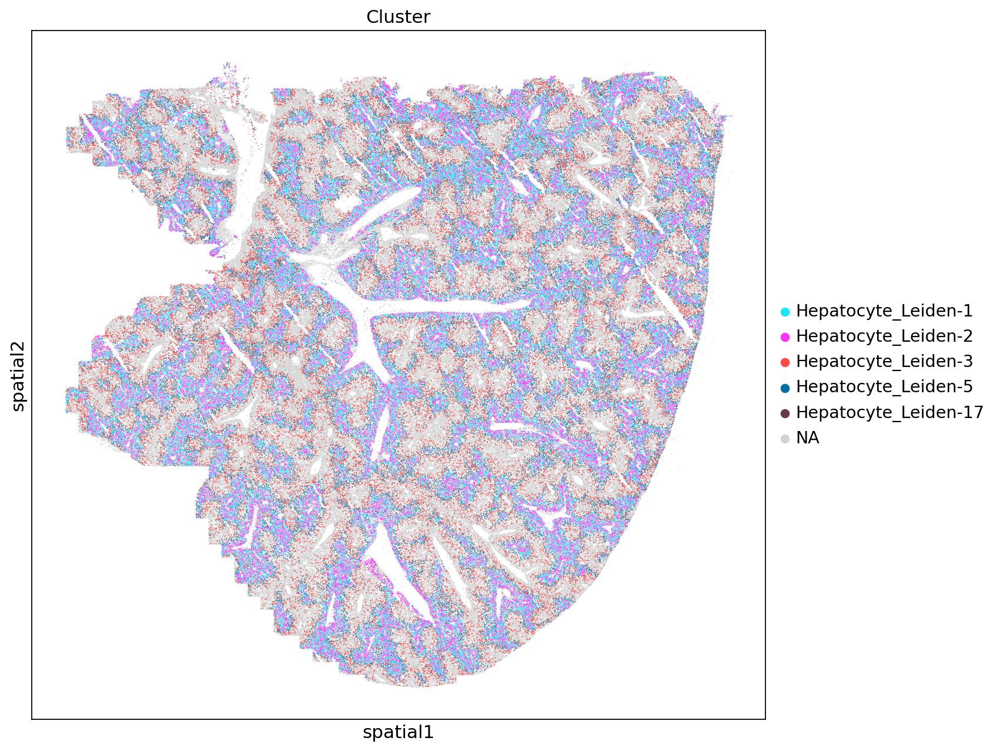

In [ ]:
sc.set_figure_params(figsize=(10,10))
sc.pl.spatial(
    adata,
    groups=peri_portal, 
    color="Cluster",
    spot_size=15,
)

# Neighborhood Enrichment
In this section we will use Squidpy to identify clusters that are spatially enriched for one another using a neighborhood enrichment test [`sq.gr.nhood_enrichment`](https://squidpy.readthedocs.io/en/stable/auto_examples/graph/compute_nhood_enrichment.html). This test determines if cells belonging to two different clusters are close to each other more often than expected. 

In order to run this test we first have to calculate a connectivity graph using the [`sq.gr.spatial_neighbors`](https://squidpy.readthedocs.io/en/stable/auto_examples/graph/compute_spatial_neighbors.html) method. This graph consists of node-cells and neighbor-relations as edges between nodes. 

<IPython.core.display.Javascript object>

  0%|          | 0/1000 [00:00<?, ?/s]

/usr/local/lib/python3.7/dist-packages/squidpy/pl/_utils.py:582: MatplotlibDeprecationWarning: In a future version, 'pad' will default to rcParams['figure.subplot.hspace'].  Set pad=0 to keep the old behavior.
  col_ax = divider.append_axes("top", size="5%")


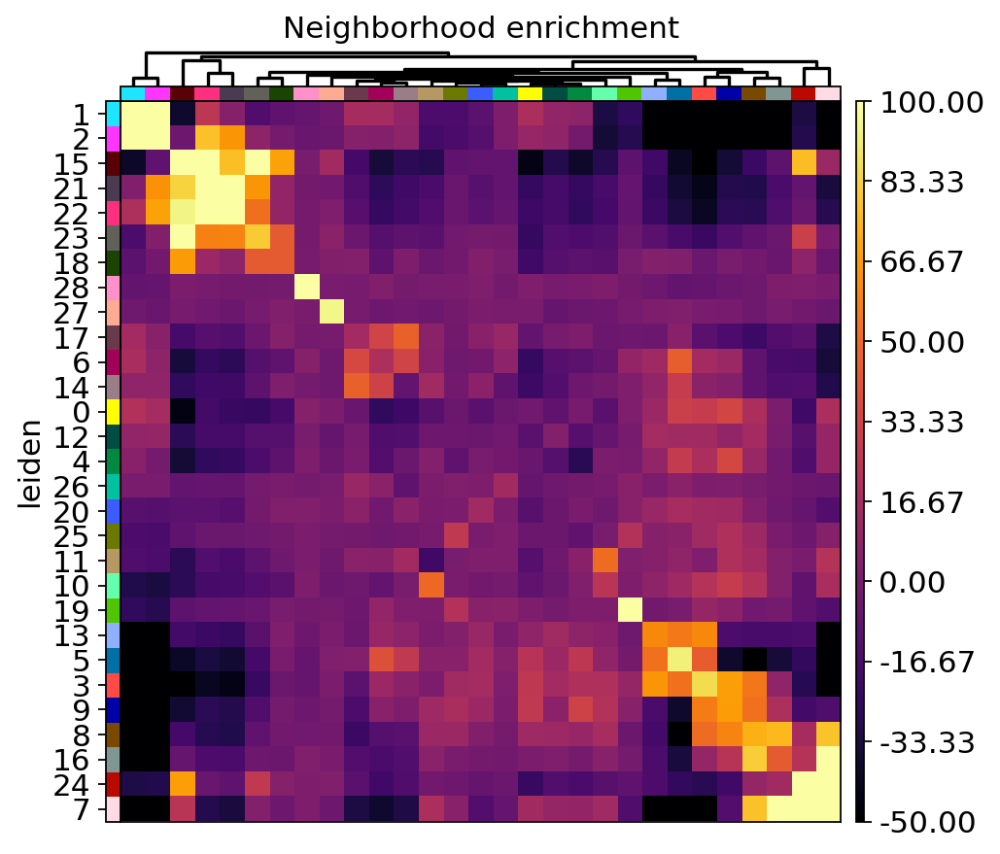

In [ ]:
sq.gr.spatial_neighbors(adata, coord_type="generic", spatial_key="spatial")
sq.gr.nhood_enrichment(adata, cluster_key="leiden")
sq.pl.nhood_enrichment(adata, cluster_key="leiden", method="average", cmap="inferno", vmin=-50, vmax=100, figsize=(5,5))

## Neighborhood Enrichment Clusters
Here we visualize clusters from our neighborhood encichment data obtained by hierarchically clustering the Z-scored neighborhood enrichment scores. We observe a cluster of two peri-portal hepatocyte leiden clusters (`Hepatocyte_Leiden-1`, and `Hepatocyte_Leiden-2`
), a large cluster consisting mainly of hepatocytes, and a cluster of cells located near blood vessels that includes Megakaryocytes and Neutrophils (`Hepatocyte_Leiden-15`, and `Hepatocyte_Leiden-21`
). This demonstrates that we can recapitulate known spatial enrichment of peri-portal and peri-central hepatocytes using neighborhood enrichment.

<IPython.core.display.Javascript object>

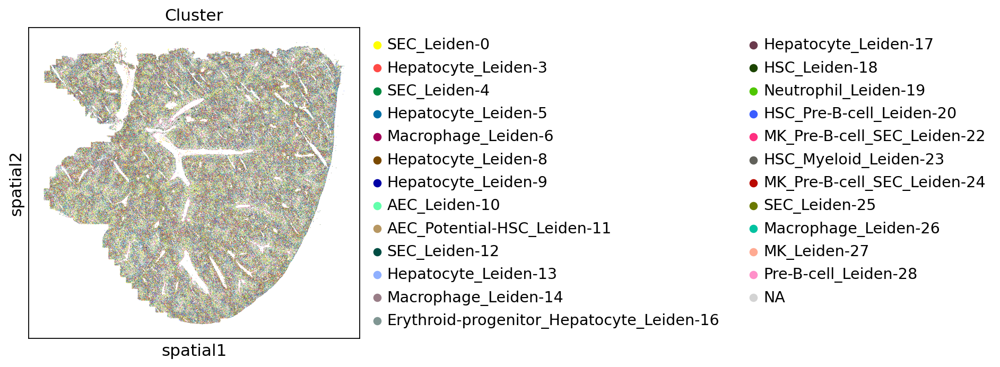

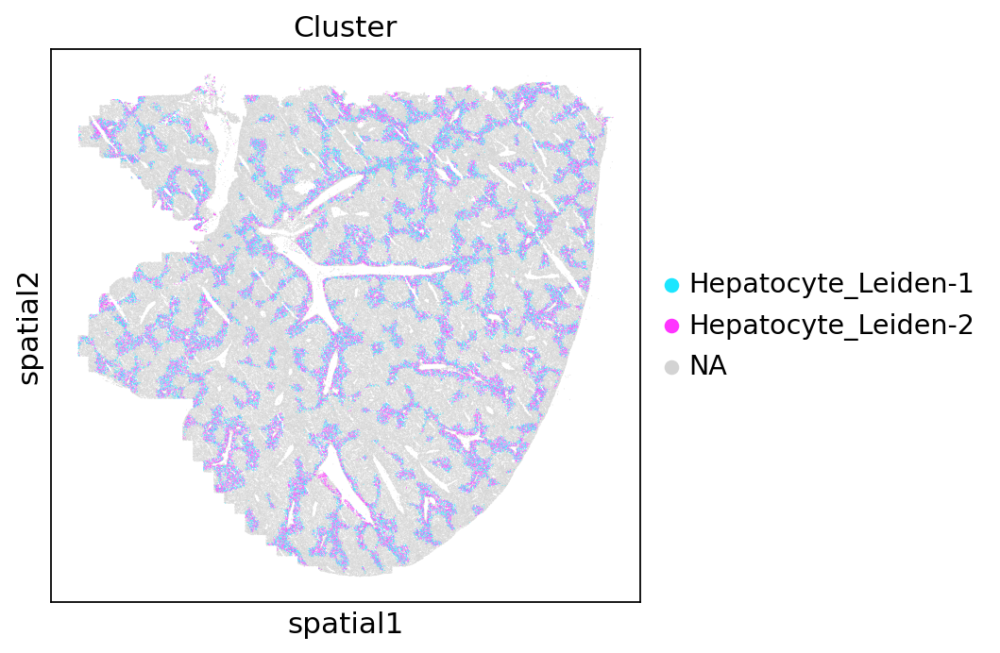

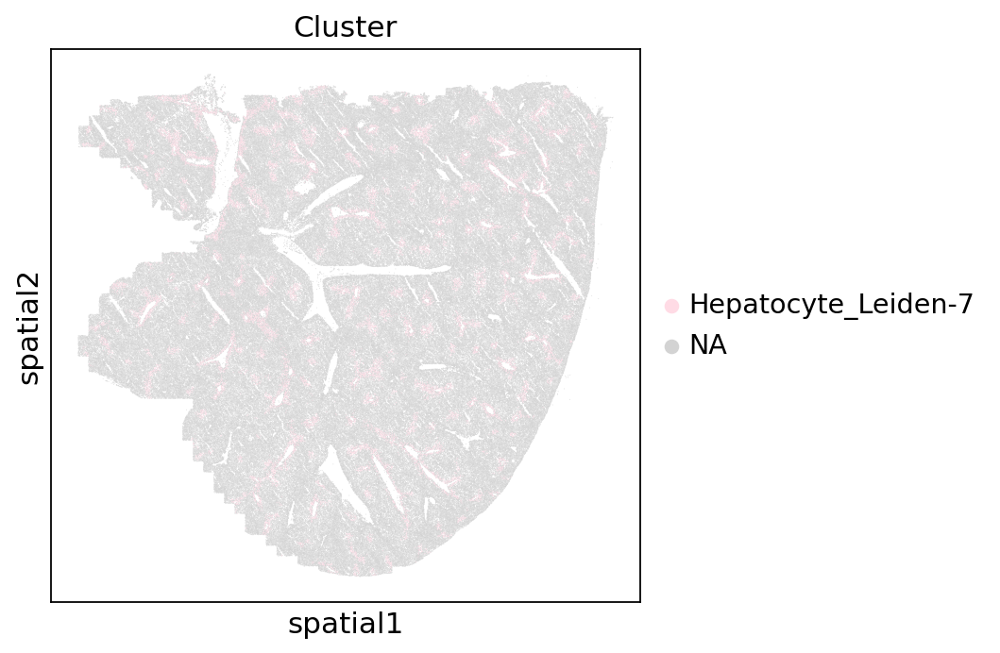

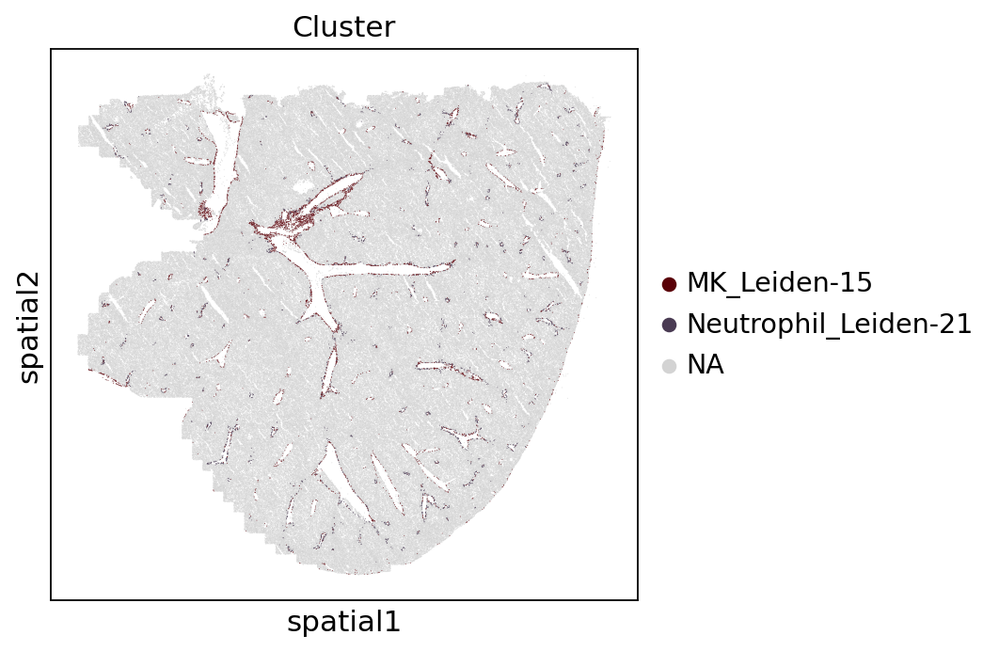

In [ ]:
n_clusters = [4]
df_nhood_enr = pd.DataFrame(adata.uns['leiden_nhood_enrichment']['zscore'], columns=leiden_clusters, index=leiden_clusters)
nhood_cluster_levels = ['Level-' + str(x) for x in n_clusters]
linkage = sch.linkage(df_nhood_enr, method='average')
mat_nhood_clusters = sch.cut_tree(linkage, n_clusters=n_clusters)
df_cluster = pd.DataFrame(mat_nhood_clusters, columns=nhood_cluster_levels, 
                                index=meta_leiden.index.tolist())

inst_level = 'Level-' + str(n_clusters[0])
all_clusters = list(df_cluster[inst_level].unique())
for inst_cluster in all_clusters:
  inst_clusters = df_cluster[df_cluster[inst_level] == inst_cluster].index.tolist()
  sc.set_figure_params(figsize=(5,5))
  sc.pl.spatial(
      adata,
      groups=inst_clusters, 
      color="Cluster",
      spot_size=15,
  )  

# Network Centrality Scores
In addition to neighborhood enrichment we can also calculate network based [centrality scores](https://squidpy.readthedocs.io/en/stable/auto_examples/graph/compute_centrality_scores.html) for the Leiden clusters. These include closeness centrality (how close group is to other nodes), clustering coeffeicient (measure of the degree to which nodes cluster), and degree centrality (fraction of connected non-group members).

In [ ]:
sq.gr.centrality_scores(adata, 'leiden')
sc.set_figure_params(figsize=(20,8))
# sq.pl.centrality_scores(adata, 'leiden')

<IPython.core.display.Javascript object>

In [ ]:
# copy centrality data to new DataFrame
df_central = deepcopy(adata.uns['leiden_centrality_scores'])
df_central.index = meta_leiden.index.tolist()

# sort clusters based on centrality scores
################################################
# closeness centrality - measure of how close the group is to other nodes.
ser_closeness = df_central['closeness_centrality'].sort_values(ascending=False)

# degree centrality - fraction of non-group members connected to group members.
# [Networkx](https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.centrality.degree_centrality.html#networkx.algorithms.centrality.degree_centrality)
# The degree centrality for a node v is the fraction of nodes it is connected to.
ser_degree = df_central['degree_centrality'].sort_values(ascending=False)

# clustering coefficient - measure of the degree to which nodes cluster together. 
ser_cluster = df_central['average_clustering'].sort_values(ascending=False)

<IPython.core.display.Javascript object>

### High Closeness Score
Four of the top five clusters based on closeness score are epithelial cells (SEC: sinusoidal epithelial cells, AEC: arterial epithelial cells) and one cluster consists of macrophages. We see that these clusters are relatively evenly distributed across the tissue which causes them to be relatively close to other clusters.

<IPython.core.display.Javascript object>

['SEC_Leiden-0', 'SEC_Leiden-4', 'Macrophage_Leiden-6', 'AEC_Potential-HSC_Leiden-11', 'AEC_Leiden-10']


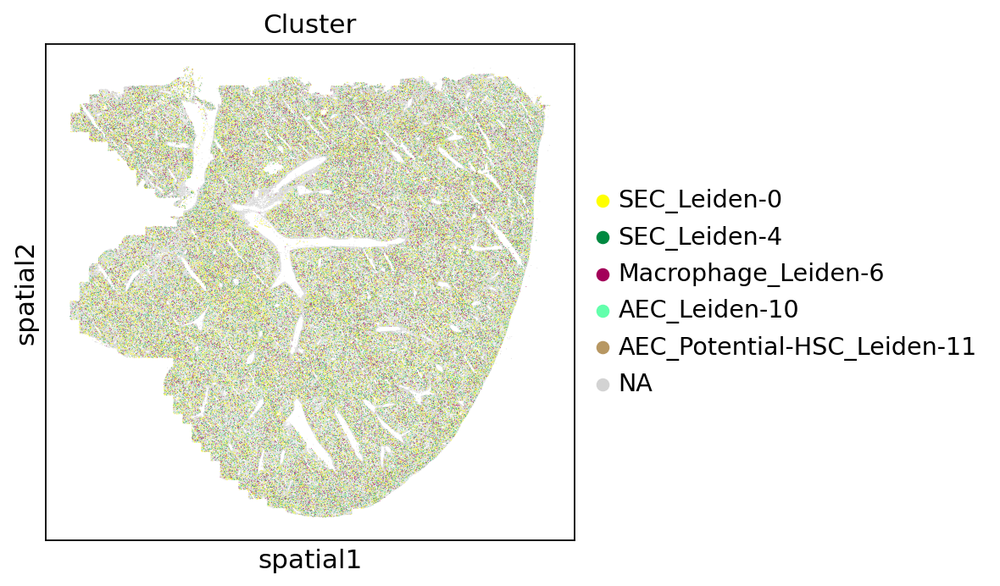

In [ ]:
inst_clusters = ser_closeness.index.tolist()[:5]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

### Low Closeness Score
We see that clusters with low closeness scores tend to be located near blood vessels and consist of megakaryocyte, neutrophil, and pre-B cells. Their distinct localization and proximity to blood vessel (e.g., only neighboring cells on one side while the other side faces the blood vessel) contributes to their low level of interactions with other clusters.

<IPython.core.display.Javascript object>

['MK_Leiden-15', 'MK_Pre-B-cell_SEC_Leiden-24', 'Neutrophil_Leiden-21', 'MK_Leiden-27', 'Pre-B-cell_Leiden-28']


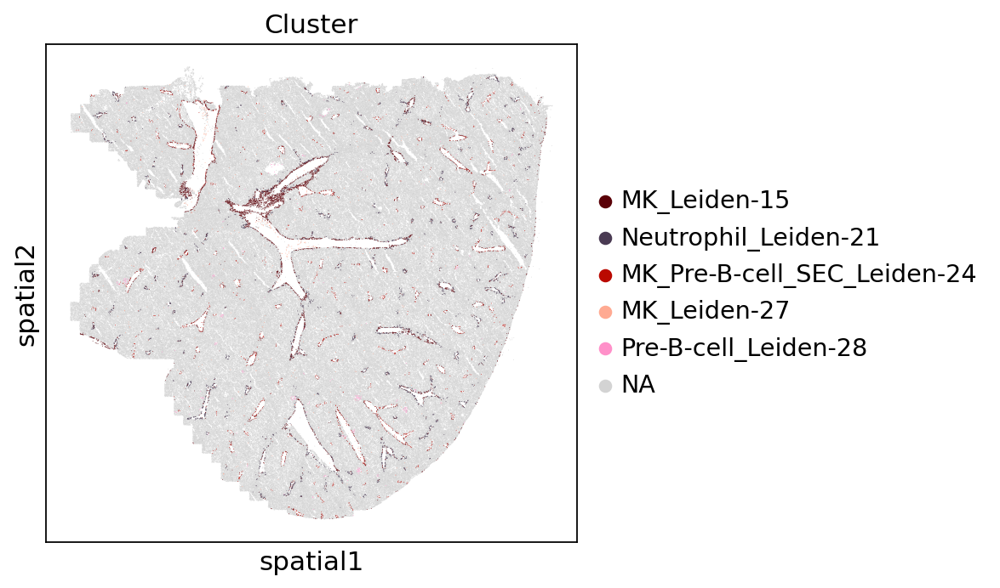

In [ ]:
inst_clusters = ser_closeness.index.tolist()[-5:]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

### High Degree Centrality
Similarly to the closeness score we observe that the SEC and Macrophage clusters (0, 4, and 6) have high degree centrality scores indicating that they have a high fraction of non-group member connections. We also note that these clusters tend to be more evenly distributed throughout the tissue.

<IPython.core.display.Javascript object>

['SEC_Leiden-0', 'SEC_Leiden-4', 'Hepatocyte_Leiden-3', 'Hepatocyte_Leiden-1', 'Macrophage_Leiden-6']


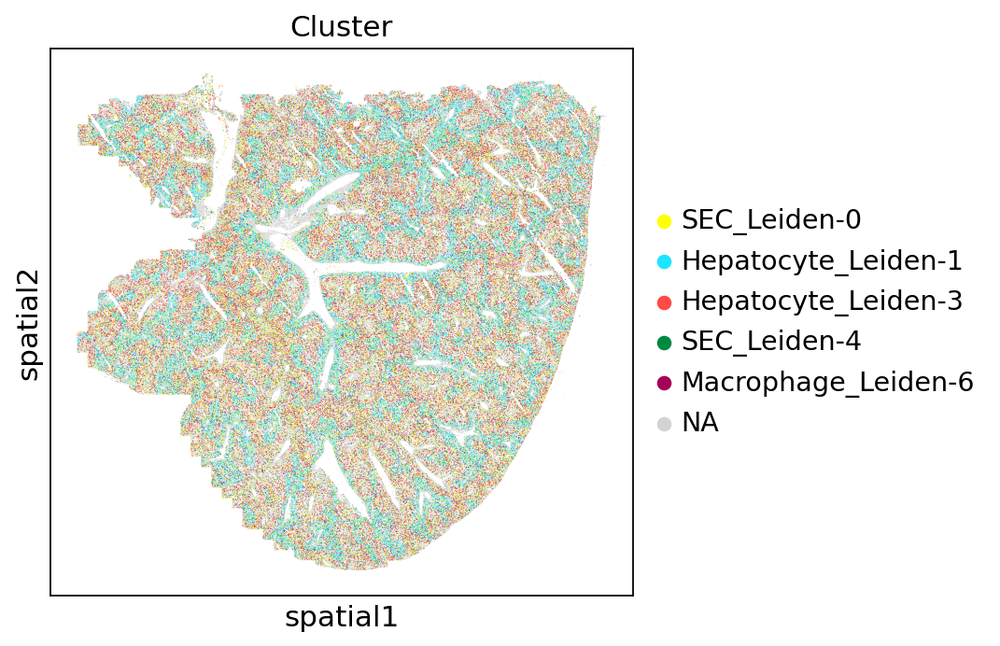

In [ ]:
inst_clusters = ser_degree.index.tolist()[:5]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

### Low Degree Centrality
These cluster have particularly low non-group member connections and similarly to the results from the closeness score we see that these clusters tend to be near blood vessels. We also note that more of the clusters tend to be lower abundance clusters (Leiden cluster numbers are ranked by abundance).


<IPython.core.display.Javascript object>

['SEC_Leiden-25', 'MK_Pre-B-cell_SEC_Leiden-24', 'Macrophage_Leiden-26', 'MK_Leiden-27', 'Pre-B-cell_Leiden-28']


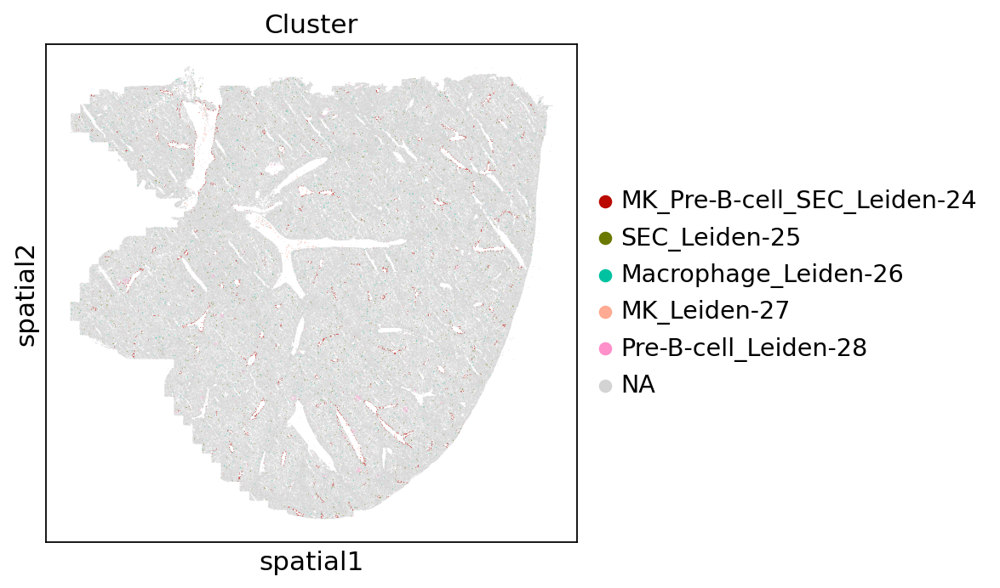

In [ ]:
inst_clusters = ser_degree.index.tolist()[-5:]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

### High Clustering Coefficient
The clustering coefficient indicates the degree to which nodes cluster together. We see that the top scoring clusters tend to be located near blood vessels. This distribution is somewhat counter-intuitive since one might expect that well segregated cells would form dense blobs rather than thin lines. However, their position along the edge of of blood vessels probably reduces the total number of neighbors each cell has since they are positioned at the border of a hole in the tissue.

<IPython.core.display.Javascript object>

['MK_Leiden-15', 'MK_Pre-B-cell_SEC_Leiden-24', 'HSC_Myeloid_Leiden-23', 'MK_Leiden-27', 'Neutrophil_Leiden-21']


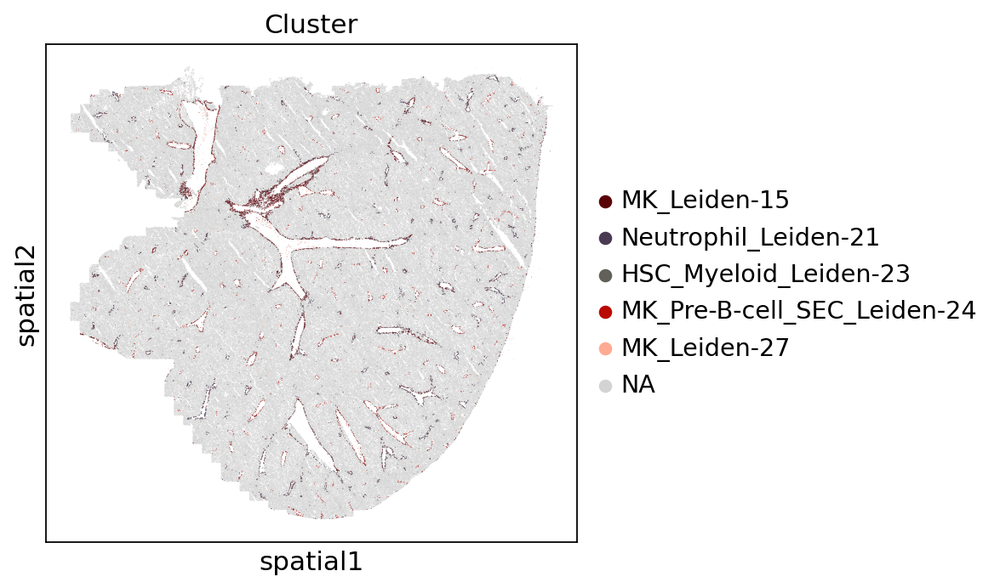

In [ ]:
inst_clusters = ser_cluster.index.tolist()[:5]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

### Low Clustering Coefficient
Again, we see that cells that are not segregated tend to be more evenly distributed throughout the tissue. Interestingly, these clusters all consist of hepatocytes and tend to avoid central veins (compared to portal veins). 

<IPython.core.display.Javascript object>

['Hepatocyte_Leiden-7', 'Hepatocyte_Leiden-17', 'Hepatocyte_Leiden-2', 'Hepatocyte_Leiden-5', 'Hepatocyte_Leiden-9']


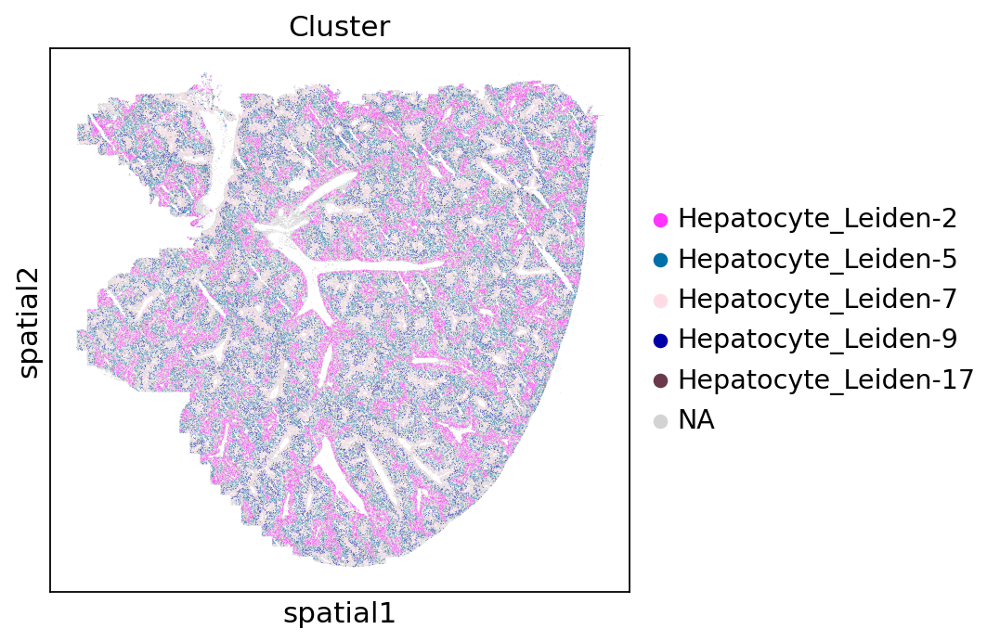

In [ ]:
inst_clusters = ser_cluster.index.tolist()[-5:]
print(inst_clusters)
sc.set_figure_params(figsize=(5,5))
sc.pl.spatial(
    adata,
    groups=inst_clusters, 
    color="Cluster",
    spot_size=15,
)  

#  Autocorrelation: Moran's I Score 
Our previous focus has been mainly on the distribution of cell clusters throughout the tissue. However we can also use Squidpy to investiagate the spatial distributions of genes expressed in the tissue. 

Here we use Squidpy to calculate the [Moran's I global spatial auto-correlation statistic](https://squidpy.readthedocs.io/en/stable/auto_examples/graph/compute_moran.html), which can be used to identify genes that are non-randomly distributed in the tissue. We will visualize the top and bottom 20 scoring genes to highlight specific examples of genes with high and low auto-correlation. 

In [ ]:
sq.gr.spatial_autocorr(adata, mode="moran")
num_view = 12
top_autocorr = adata.uns['moranI']['I'].sort_values(ascending=False).head(num_view).index.tolist()
bot_autocorr = adata.uns['moranI']['I'].sort_values(ascending=True).head(num_view).index.tolist()

<IPython.core.display.Javascript object>

### Genes with high spatial autocorrelation
We note that many of the top scoring genes show expression patterns following the spatial pattern of hepatocyte Leiden clusters (e.g. Aldh1b1, Aldh3a20) and blood vessels (e.g. Dpt, Sfrp1). We can also check which cell types are most associated with these highly auto-correlated genes by ranking cell clusters based on their expression of these genes (e.g. mean expression). Below we see that three of the top five cell clusters are hepatocytes, which agrees with the gene's localization patterns. These results indicate the primary spatial patterns in gene expression auto-correlation are being driven by their expression in hepatocytes and blood vessel associated cell types.

<IPython.core.display.Javascript object>

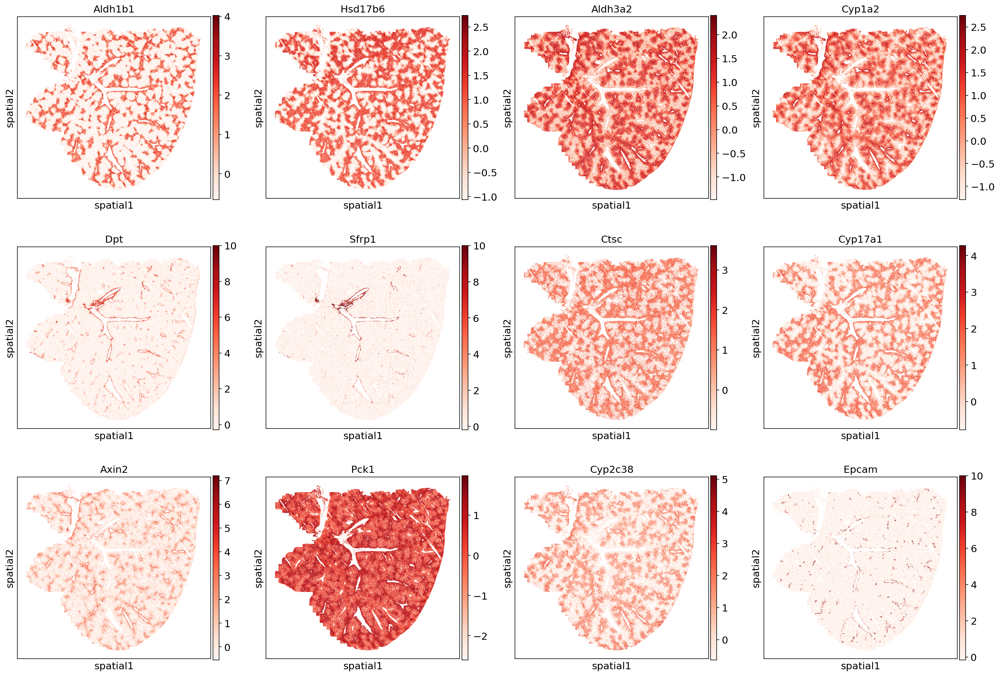

In [ ]:
sc.pl.spatial(
    adata,
    color=top_autocorr,
    spot_size=20,
    cmap='Reds'
)

In [ ]:
# top cell types based on average expression of top_autocorr genes
sig_leiden.loc[top_autocorr].mean(axis=0).sort_values(ascending=False).index.tolist()[:5]

<IPython.core.display.Javascript object>

['Neutrophil_Leiden-21',
 'MK_Leiden-15',
 'Hepatocyte_Leiden-2',
 'Hepatocyte_Leiden-7',
 'Hepatocyte_Leiden-1']

### Genes with low autocorrelation
Genes with low auto-correlation show more evenly distributed expression patterns. Three of the top five clusters based on average expression of these genes are sinusoidal epithelial cells (SEC) which show a more evenly distributed spatial distribution throughout the liver.

<IPython.core.display.Javascript object>

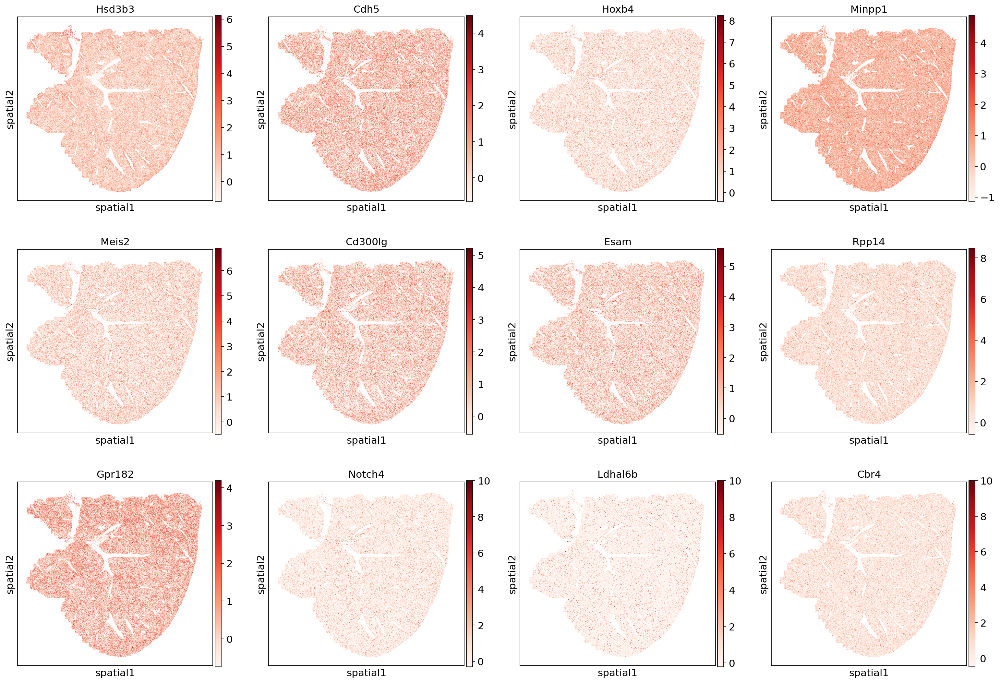

In [ ]:
sc.pl.spatial(
    adata,
    color=bot_autocorr,
    spot_size=20,
    cmap='Reds'
)

In [ ]:
# top cell types based on average expression of bot_autocorr genes
sig_leiden.loc[bot_autocorr].mean(axis=0).sort_values(ascending=False).index.tolist()[:5]

<IPython.core.display.Javascript object>

['SEC_Leiden-4',
 'MK_Pre-B-cell_SEC_Leiden-24',
 'SEC_Leiden-25',
 'MK_Pre-B-cell_SEC_Leiden-22',
 'SEC_Leiden-12']